In [1]:
import json
from shapely.geometry import shape, MultiPolygon

# Read GeoJSON file
with open('querycounty.json') as f:
    data = json.load(f)

# Extract polygons from GeoJSON and convert to Shapely Polygon objects
polygons = []
for feature in data['features']:
    geom_type = feature['geometry']['type']
    coords = feature['geometry']['coordinates']
    if geom_type == 'Polygon':
        polygons.append(shape(feature['geometry']))
    elif geom_type == 'MultiPolygon':
        for poly_coords in coords:
            polygons.append(shape({'type': 'Polygon', 'coordinates': poly_coords}))


# Create a MultiPolygon object
multipolygon = MultiPolygon(polygons)
multipolygon

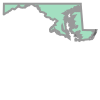

In [2]:
import geopandas as gpd
state_shp_path = 'ne_10m_admin_1_states_provinces/ne_10m_admin_1_states_provinces.shp'
state_gdf = gpd.read_file(state_shp_path)
maryland = state_gdf.iloc[2083]['geometry']
maryland

C:\Users\aspen\AppData\Local\Temp\ipykernel_15128\2947482971.py:79: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  obs = [float(df_sub[df_sub['station_id'] == sid][var]) for sid in coord_dict]


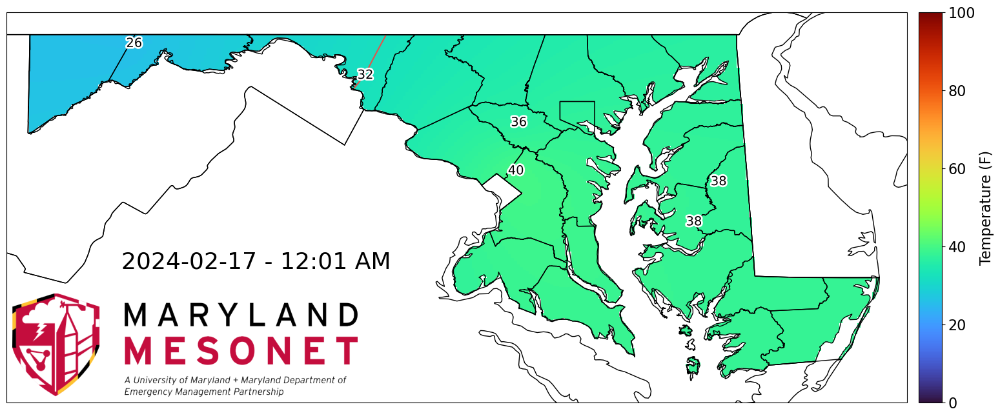

In [40]:
import cartopy.crs as ccrs
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patheffects as pe
import cartopy
from scipy.interpolate import griddata
from scipy.interpolate import RBFInterpolator
import numpy as np
import shapely.vectorized
from cartopy.feature import ShapelyFeature
from datetime import datetime
import pytz

df = pd.read_csv('all_2024-02-16_2024-02-19.csv')

df['Air_Temperature_Avg'] = df['Air_Temperature_Avg']*9/5 + 32
df['Snow_Depth_Avg'] = df['Snow_Depth_Avg']*39.3701
df['WS_Mean'] = df['WS_Mean']*2.23694

var = 'Air_Temperature_Avg'

cmap_dict = {
    'Air_Temperature_Avg': 'turbo',
    'Solar_Radiation_Avg': 'YlOrRd',
    'Snow_Depth_Avg': 'Purples',
    'Relative_Humidity': 'YlGn',
    'SLP': 'bwr',
    'Rain_ICA_Tot': 'ocean_r',
    'WS_Mean': 'BuPu',
}

label_dict = {
    'Air_Temperature_Avg': 'Temperature (F)',
    'Solar_Radiation_Avg': 'Solar Radiation (W/m^2)',
    'Snow_Depth_Avg': 'Snow Depth (in)',
    'Relative_Humidity': 'Relative Humidity (%)',
    'SLP': 'Sea Level Pressure (mb)',
    'Rain_ICA_Tot': 'bwr',
    'WS_Mean': 'Wind Speed (mph)',
}

lims_dict = {
    'Air_Temperature_Avg': (0,100),
    'Solar_Radiation_Avg': (0,800),
    'Snow_Depth_Avg': (0,12),
    'Relative_Humidity': (0,100),
    'SLP': (1013.15 - 20, 1013.15 + 20),
    'Rain_ICA_Tot': (0,8),
    'WS_Mean': (0,30),
}

coord_dict = {
    'MDMSNT-01': (39.26249, -76.92580),
    'MDMSNT-02': (39.67557, -78.93353),
    'MDMSNT-03': (39.50959, -77.72659),
    'MDMSNT-04': (38.74357, -76.01185),
    'MDMSNT-05': (38.95357, -75.88281),
    'MDMSNT-06': (39.0099, -76.94110),
}

tlat = 39.84
blat = 37.8
llon = -79.6
rlon = -74.9

lats = [coords[0] for coords in coord_dict.values()]
lons = [coords[1] for coords in coord_dict.values()]
coords = list(coord_dict.values())

est = pytz.timezone('US/Eastern')
utc = pytz.utc

timestamp = '2024-02-17 05:01:00'
dt = datetime.strptime(timestamp, "%Y-%m-%d %H:%M:%S").replace(tzinfo=utc).astimezone(est)

df_sub = df[df['TMSTAMP'] == timestamp]

obs = [float(df_sub[df_sub['station_id'] == sid][var]) for sid in coord_dict]
if var == 'WS_Mean':
    wind_dir = [float(df_sub[df_sub['station_id'] == sid]['WD_Mean']) for sid in coord_dict]

fig = plt.figure(figsize=(18,12))
ax = fig.add_subplot(projection=ccrs.PlateCarree())

xgrid = np.mgrid[blat:tlat:300j, llon:rlon:300j]
xflat = xgrid.reshape(2, -1).T

yflat = RBFInterpolator(coords, obs, kernel='linear')(xflat)
ygrid = yflat.reshape(300, 300)

mask = shapely.vectorized.contains(maryland, xgrid[1], xgrid[0])

# counties_feature = ShapelyFeature(county_gdf['geometry'], ccrs.PlateCarree(), edgecolor='grey', facecolor='none', linewidth=1)
# ax.add_feature(counties_feature)

# ax.add_geometries(maryland, ccrs.PlateCarree(), facecolor='none')

ax.add_geometries([multipolygon], ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=1)

im = ax.pcolormesh(xgrid[1], xgrid[0],
                   # ygrid,
                   np.where(mask, ygrid, np.nan),
                   cmap=cmap_dict[var],
                   # shading='gouraud',
                   vmin=lims_dict[var][0], vmax=lims_dict[var][1]
                  )

# ax.scatter(np.array(coords).T[1], np.array(coords).T[0], edgecolor='black', color='white', s=15)

ax.contour(xgrid[1], xgrid[0], np.where(mask, ygrid, np.nan), levels=[32], colors=['#e1554c'])

# print('here')
for i, p in enumerate(coords):
    # print('ooga booga')
    if not np.isnan(obs[i]):
        ax.text(p[1], p[0], round(obs[i]), horizontalalignment='center', verticalalignment='center', fontsize=14,
               color='black', path_effects=[pe.withStroke(linewidth=4, foreground='white')])
        if var == 'WS_Mean':
            ax.barbs(p[1], p[0], round(obs[i]*0.868976)*np.cos(np.pi*wind_dir[i]/180), round(obs[i]*0.868976)*np.sin(np.pi*wind_dir[i]/180), linewidth=2, length=8)
            # ax.barbs(p[1], p[0], round(obs[i]), wind_dir[i], linewidth=2)

# ax.text(coords[0][1], coords[0][0], '34.5')
ax.text(-79, 38.5, dt.strftime("%Y-%m-%d - %I:%M %p"), fontsize=26)


# read image file
with mpl.cbook.get_sample_data(r'C:\Users\aspen\mesonet\MdMesonet [Logo+Wordmark+Tagline2.15].png') as file:
    arr_image = plt.imread(file, format='png')
 
# Draw image
axin = ax.inset_axes([-79.57, 37.2, 1.8, 1.8],transform=ax.transData)    # create new inset axes in data coordinates
axin.imshow(arr_image)
axin.axis('off')


# ax.add_feature(cartopy.feature.COASTLINE)
ax.add_feature(cartopy.feature.STATES)
ax.set_xlim((llon, rlon))
ax.set_ylim((blat, tlat))

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0,0.02,ax.get_position().height])
cb1 = plt.colorbar(im, cax=cax,)
cb1.ax.tick_params(labelsize=16)
cb1.set_label(label=label_dict[var], size=16)

# plt.colorbar(im)

(-0.5, 674.5, 202.5, -0.5)

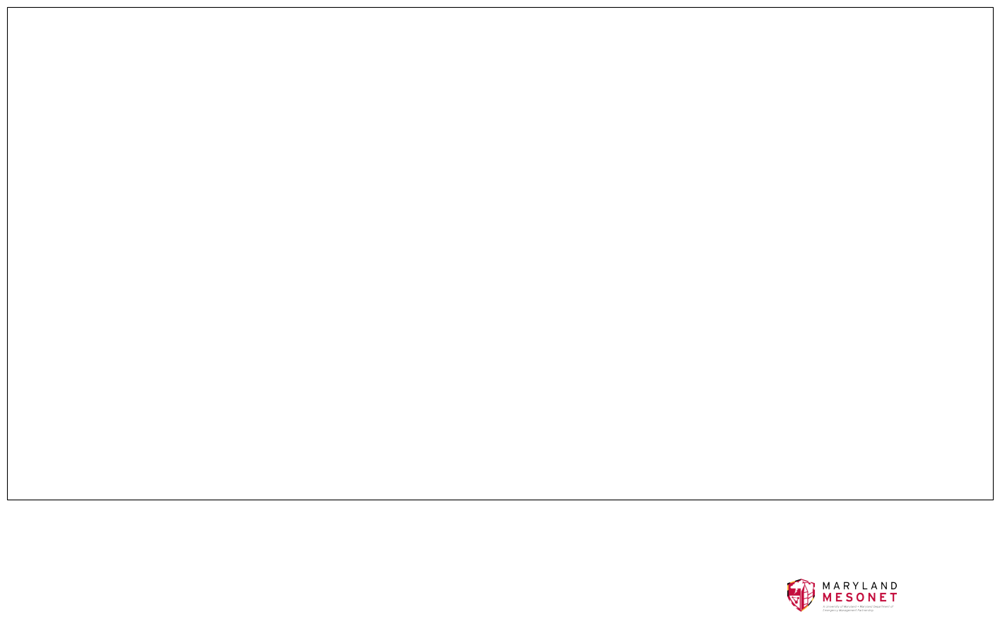

In [27]:

fig = plt.figure(figsize=(18,12))
ax = fig.add_subplot(projection=ccrs.PlateCarree())
# read image file
with mpl.cbook.get_sample_data(r'C:\Users\aspen\mesonet\MdMesonet [Logo+Wordmark+Tagline2.15].png') as file:
    arr_image = plt.imread(file, format='png')

# Draw image
axin = ax.inset_axes([105,-145,40,40],transform=ax.transData)    # create new inset axes in data coordinates
axin.imshow(arr_image)
axin.axis('off')



In [25]:
wind_dir

[303.463, 257.611, 296.468, 328.601, 339.094, 338.121]

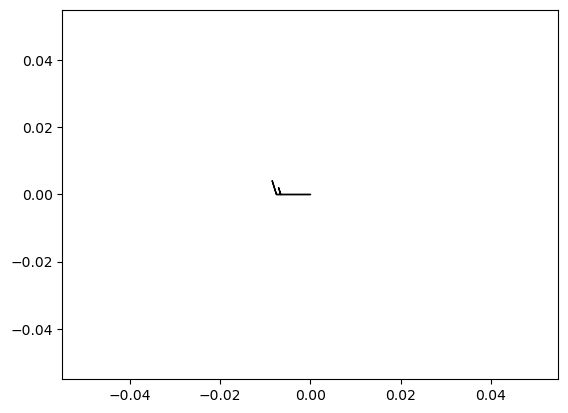

In [18]:
plt.barbs(0,0,15,0)

In [41]:
df_sub

,TMSTAMP,Air_Temperature_Avg,Relative_Humidity,SLP,Rain_ICA_Tot,WS_Mean,Wind_Speed_Max,Snow_Depth_Avg,Solar_Radiation_Avg,Soil_Temperature_5cm,Soil_Temperature_10cm,Soil_Temperature_20cm,Soil_Temperature_50cm,Soil_Temperature_100cm,Soil_Moisture_5cm,Soil_Moisture_10cm,Soil_Moisture_20cm,Soil_Moisture_50cm,Soil_Moisture_100cm,station_id
1200,2024-02-08 20:40:00,54.90194,32.79,1023.25,0,7.441069,3.88733,-1.362328,251.869,7.019,6.812,7.164,8.250,8.600,0.395,0.343,0.353,0.424,0.379,MDMSNT-06
1201,2024-02-08 20:40:00,50.14580,47.88,1024.74,0,6.049737,3.88733,0.418858,117.528,10.160,8.900,7.246,5.456,7.187,0.191,0.290,0.324,0.350,0.277,MDMSNT-04
1202,2024-02-08 20:40:00,52.90574,38.36,1021.93,0,8.372755,4.55373,0.085241,119.725,6.464,4.824,3.317,4.788,6.509,0.278,0.305,0.299,0.356,0.424,MDMSNT-03
1203,2024-02-08 20:40:00,52.22156,43.15,1024.32,0,5.459677,3.22093,NaN,180.531,8.660,7.246,4.910,4.980,6.583,0.169,0.212,0.224,0.280,0.267,MDMSNT-05
1204,2024-02-08 20:40:00,48.21548,38.12,1019.81,0,2.043496,1.44387,0.289199,421.385,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MDMSNT-02
1205,2024-02-08 20:40:00,52.72520,37.45,1023.61,0,4.062149,2.77667,-0.097953,192.235,6.312,4.797,3.791,4.690,6.309,0.321,0.360,0.251,0.329,0.368,MDMSNT-01


In [4]:
df

,TMSTAMP,Air_Temperature_Avg,Relative_Humidity,SLP,Rain_ICA_Tot,WS_Mean,Wind_Speed_Max,Snow_Depth_Avg,Solar_Radiation_Avg,Soil_Temperature_5cm,...,Soil_Temperature_20cm,Soil_Temperature_50cm,Soil_Temperature_100cm,Soil_Moisture_5cm,Soil_Moisture_10cm,Soil_Moisture_20cm,Soil_Moisture_50cm,Soil_Moisture_100cm,station_id,temp_f
0,2024-02-09 00:00:00,9.3574,44.71,1021.43,0,2.221330,2.943270,-0.014716,-0.226,5.471,...,4.097,4.760,6.526,0.279,0.306,0.299,0.356,0.424,MDMSNT-03,48.84332
1,2024-02-09 00:00:00,6.7680,58.50,1024.44,0,1.019040,1.388330,0.015953,-0.719,4.852,...,6.550,5.784,7.164,0.190,0.289,0.323,0.350,0.277,MDMSNT-04,44.18240
2,2024-02-09 00:00:00,7.0760,53.91,1024.22,0,1.407770,2.110270,NaN,0.258,5.065,...,5.447,5.104,6.565,0.168,0.212,0.224,0.279,0.267,MDMSNT-05,44.73680
3,2024-02-09 00:00:00,7.5767,42.16,1018.91,0,0.999600,1.277270,0.005878,-10.617,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MDMSNT-02,45.63806
4,2024-02-09 00:00:00,7.7106,51.27,1022.75,0,1.404990,2.054730,-0.035405,-0.631,7.370,...,7.352,8.200,8.600,0.393,0.342,0.352,0.424,0.378,MDMSNT-06,45.87908
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8640,2024-02-08 00:00:00,3.9624,57.95,1025.74,0,0.849660,0.999600,-0.000487,-1.118,2.145,...,5.380,5.631,7.329,0.198,0.293,0.325,0.351,0.277,MDMSNT-04,39.13232
8641,2024-02-08 00:00:00,2.4970,49.93,1022.81,0,0.558110,0.721933,-0.004254,-7.729,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MDMSNT-02,36.49460
8642,2024-02-08 00:00:00,2.5203,67.94,1025.42,0,0.202697,0.444267,NaN,0.911,2.352,...,4.069,5.044,6.740,0.176,0.213,0.228,0.281,0.267,MDMSNT-05,36.53654
8643,2024-02-08 00:00:00,0.3084,73.16,1025.61,0,0.000000,0.000000,-0.002279,-3.352,3.551,...,3.933,4.748,6.416,0.321,0.361,0.253,0.330,0.368,MDMSNT-01,32.55512


In [10]:
import geopandas as gpd

In [18]:
county_gdf['geometry']

0     POLYGON ((-8786272.026 4825737.537, -8801689.7...
1     POLYGON ((-8720521.162 4825706.592, -8720453.1...
2     POLYGON ((-8428247.548 4670479.988, -8428237.4...
3     POLYGON ((-8355807.143 4634745.881, -8355826.3...
4     POLYGON ((-8610855.681 4825319.273, -8602465.4...
5     POLYGON ((-8500993.141 4779624.323, -8500997.0...
6     POLYGON ((-8523083.108 4809397.857, -8523079.0...
7     POLYGON ((-8548088.613 4825398.749, -8548328.6...
8     POLYGON ((-8434379.079 4777193.372, -8434298.6...
9     POLYGON ((-8571171.612 4717929.034, -8571164.1...
10    POLYGON ((-8571171.612 4717929.034, -8571256.1...
11    POLYGON ((-8470156.007 4713655.482, -8470148.3...
12    POLYGON ((-8470778.689 4713647.761, -8470801.7...
13    POLYGON ((-8487273.156 4564012.210, -8487384.7...
14    POLYGON ((-8428247.548 4670479.988, -8428255.1...
15    POLYGON ((-8421760.085 4621067.757, -8421750.7...
16    POLYGON ((-8426939.817 4656999.233, -8426812.7...
17    POLYGON ((-8721079.078 4825648.304, -87210

In [12]:
np.array(coords)

array([[ 39.26249, -76.9258 ],
       [ 39.67557, -78.93353],
       [ 39.50959, -77.72659],
       [ 38.74357, -76.01185],
       [ 38.95357, -75.88281]])

['2024-01-14 14:00:00', '2024-01-14 14:05:00', '2024-01-14 14:10:00', '2024-01-14 14:15:00', '2024-01-14 14:20:00', '2024-01-14 14:25:00', '2024-01-14 14:30:00', '2024-01-14 14:35:00', '2024-01-14 14:40:00', '2024-01-14 14:45:00', '2024-01-14 14:50:00', '2024-01-14 14:55:00', '2024-01-14 15:00:00', '2024-01-14 15:05:00', '2024-01-14 15:10:00', '2024-01-14 15:15:00', '2024-01-14 15:20:00', '2024-01-14 15:25:00', '2024-01-14 15:30:00', '2024-01-14 15:35:00', '2024-01-14 15:40:00', '2024-01-14 15:45:00', '2024-01-14 15:50:00', '2024-01-14 15:55:00', '2024-01-14 16:00:00', '2024-01-14 16:05:00', '2024-01-14 16:10:00', '2024-01-14 16:15:00', '2024-01-14 16:20:00', '2024-01-14 16:25:00', '2024-01-14 16:30:00', '2024-01-14 16:35:00', '2024-01-14 16:40:00', '2024-01-14 16:45:00', '2024-01-14 16:50:00', '2024-01-14 16:55:00', '2024-01-14 17:00:00', '2024-01-14 17:05:00', '2024-01-14 17:10:00', '2024-01-14 17:15:00', '2024-01-14 17:20:00', '2024-01-14 17:25:00', '2024-01-14 17:30:00', '2024-01-1

2024-01-14 14:00:00


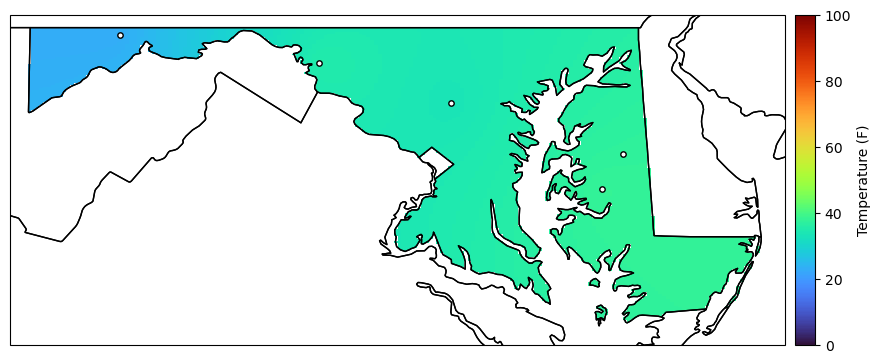

In [86]:
from matplotlib.animation import FuncAnimation

df = pd.read_csv('all_2024-01-14_2024-01-15.csv')
df['temp_f'] = df['Air_Temperature_Avg']*9/5 + 32

coord_dict = {
    'MDMSNT-01': (39.26249, -76.92580),
    'MDMSNT-02': (39.67557, -78.93353),
    'MDMSNT-03': (39.50959, -77.72659),
    'MDMSNT-04': (38.74357, -76.01185),
    'MDMSNT-05': (38.95357, -75.88281),
}

tlat = 39.8
blat = 37.8
llon = -79.6
rlon = -74.9

lats = [coords[0] for coords in coord_dict.values()]
lons = [coords[1] for coords in coord_dict.values()]
coords = list(coord_dict.values())

xgrid = np.mgrid[blat:tlat:200j, llon:rlon:200j]
xflat = xgrid.reshape(2, -1).T

mask = shapely.vectorized.contains(maryland, xgrid[1], xgrid[0])

start_date_str = '2024-01-14 14:00:00'
end_date_str = '2024-01-14 19:00:00'
timestamps = generate_time_strings(start_date_str, end_date_str)
print(timestamps)

# Function to update the plot in each animation frame
def update(frame):
    # print('FOSKFKJLD')
    print(frame)
    
    df_sub = df[df['TMSTAMP'] == frame]
    
    temp_obs = [float(df_sub[df_sub['station_id'] == sid]['temp_f'].iloc[0]) for sid in coord_dict]
    
    yflat = RBFInterpolator(coords, temp_obs, kernel='linear')(xflat)
    ygrid = yflat.reshape(200, 200)

    im.set_array(np.where(mask, ygrid, np.nan))

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(projection=ccrs.PlateCarree())


df_sub = df[df['TMSTAMP'] == start_date_str]

temp_obs = [float(df_sub[df_sub['station_id'] == sid]['temp_f'].iloc[0]) for sid in coord_dict]

yflat = RBFInterpolator(coords, temp_obs, kernel='linear')(xflat)
ygrid = yflat.reshape(200, 200)

im = ax.pcolormesh(xgrid[1], xgrid[0],
                   # ygrid,
                   np.where(mask, ygrid, np.nan),
                   cmap='turbo',
                   # shading='gouraud',
                   vmin=0, vmax=100
                  )
    
ax.scatter(np.array(coords).T[1], np.array(coords).T[0], edgecolor='black', color='white', s=15)

ax.add_feature(cartopy.feature.COASTLINE)
ax.add_feature(cartopy.feature.STATES)
ax.set_xlim((llon, rlon))
ax.set_ylim((blat, tlat))

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0,0.02,ax.get_position().height])
cb1 = plt.colorbar(im, cax=cax,
             label='Temperature (F)',
            )

# Create the animation using FuncAnimation
animation = FuncAnimation(fig, update, frames=timestamps,)
HTML(animation.to_jshtml())

In [82]:
df_sub[df_sub['station_id'] == 'MDMSNT-05']['temp_f']

3000    37.26986
Name: temp_f, dtype: float64

init
init
init
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99


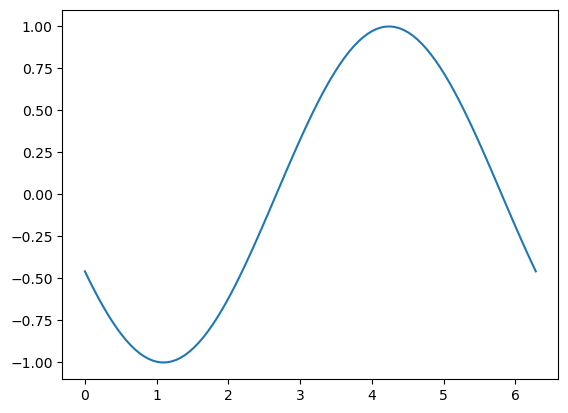

In [75]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Function to initialize the plot
def init():
    print('init')
    line.set_ydata(np.ma.array(x, mask=True))
    return line,

# Function to update the plot at each animation frame
def update(frame):
    print(frame)
    y = np.sin(x + frame * 0.1)  # Example: update with a sine wave
    line.set_ydata(y)
    return line,

# Create a figure and axes
fig, ax = plt.subplots()
x = np.linspace(0, 2 * np.pi, 100)
line, = ax.plot(x, np.sin(x))

# Create the animation using FuncAnimation
animation = FuncAnimation(fig, update, frames=range(100), init_func=init, blit=True)

HTML(animation.to_jshtml())
# animation

In [57]:
from datetime import datetime, timedelta

def generate_time_strings(start_date_str, end_date_str):
    time_format = '%Y-%m-%d %H:%M:%S'
    start_date = datetime.strptime(start_date_str, time_format)
    end_date = datetime.strptime(end_date_str, time_format)

    current_date = start_date
    time_strings = []

    while current_date <= end_date:
        time_strings.append(current_date.strftime(time_format))
        current_date += timedelta(minutes=5)

    return time_strings

# Example usage:
start_date_str = '2024-01-14 19:00:00'
end_date_str = '2024-01-15 00:00:00'

result = generate_time_strings(start_date_str, end_date_str)

2024-01-14 19:00:00
2024-01-14 19:05:00
2024-01-14 19:10:00
2024-01-14 19:15:00
2024-01-14 19:20:00
2024-01-14 19:25:00
2024-01-14 19:30:00
2024-01-14 19:35:00
2024-01-14 19:40:00
2024-01-14 19:45:00
2024-01-14 19:50:00
2024-01-14 19:55:00
2024-01-14 20:00:00
2024-01-14 20:05:00
2024-01-14 20:10:00
2024-01-14 20:15:00
2024-01-14 20:20:00
2024-01-14 20:25:00
2024-01-14 20:30:00
2024-01-14 20:35:00
2024-01-14 20:40:00
2024-01-14 20:45:00
2024-01-14 20:50:00
2024-01-14 20:55:00
2024-01-14 21:00:00
2024-01-14 21:05:00
2024-01-14 21:10:00
2024-01-14 21:15:00
2024-01-14 21:20:00
2024-01-14 21:25:00
2024-01-14 21:30:00
2024-01-14 21:35:00
2024-01-14 21:40:00
2024-01-14 21:45:00
2024-01-14 21:50:00
2024-01-14 21:55:00
2024-01-14 22:00:00
2024-01-14 22:05:00
2024-01-14 22:10:00
2024-01-14 22:15:00
2024-01-14 22:20:00
2024-01-14 22:25:00
2024-01-14 22:30:00
2024-01-14 22:35:00
2024-01-14 22:40:00
2024-01-14 22:45:00
2024-01-14 22:50:00
2024-01-14 22:55:00
2024-01-14 23:00:00
2024-01-14 23:05:00


In [125]:
df_sub

,TMSTAMP,Air_Temperature_Avg,Relative_Humidity,SLP,Rain_ICA_Tot,WS_Mean,Wind_Speed_Max,Snow_Depth_Avg,Solar_Radiation_Avg,Soil_Temperature_5cm,Soil_Temperature_10cm,Soil_Temperature_20cm,Soil_Temperature_50cm,Soil_Temperature_100cm,Soil_Moisture_5cm,Soil_Moisture_10cm,Soil_Moisture_20cm,Soil_Moisture_50cm,Soil_Moisture_100cm,station_id
3600,2024-02-02 12:00:00,5.5760,88.00,1010.14,0.0,0.047203,0.277667,0.007413,0.061,5.302,5.534,6.028,7.063,8.070,0.321,0.336,0.347,0.360,0.279,MDMSNT-04
3601,2024-02-02 12:00:00,4.7488,90.90,1009.92,0.0,0.000000,0.000000,NaN,2.690,4.952,5.220,5.646,6.568,7.449,0.239,0.241,0.246,0.286,0.269,MDMSNT-05
3602,2024-02-02 12:00:00,8.3980,72.79,1010.63,0.0,3.204270,4.387130,-0.008440,-0.327,5.459,5.574,5.715,5.839,6.654,0.303,0.318,0.310,0.362,0.425,MDMSNT-03
3603,2024-02-02 12:00:00,2.9370,88.10,1010.71,0.0,3.879000,5.331200,0.001926,-6.867,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MDMSNT-02
3604,2024-02-02 12:00:00,4.3863,97.10,1010.81,0.0,0.136057,0.444267,0.011911,-2.548,4.931,5.120,5.347,5.839,6.746,0.333,0.370,0.262,0.370,0.368,MDMSNT-01


In [126]:
temp_obs

[4.3863, 2.937, 8.398, 5.576, 4.7488]

In [127]:
coords

[(39.26249, -76.9258),
 (39.67557, -78.93353),
 (39.50959, -77.72659),
 (38.74357, -76.01185),
 (38.95357, -75.88281)]

In [124]:
import geopandas as gpd

ModuleNotFoundError: No module named 'geopandas'

In [9]:
df[df['TMSTAMP'] == '2024-02-03 00:00:00']

,TMSTAMP,Air_Temperature_Avg,Relative_Humidity,SLP,Rain_ICA_Tot,WS_Mean,Wind_Speed_Max,Snow_Depth_Avg,Solar_Radiation_Avg,Soil_Temperature_5cm,Soil_Temperature_10cm,Soil_Temperature_20cm,Soil_Temperature_50cm,Soil_Temperature_100cm,Soil_Moisture_5cm,Soil_Moisture_10cm,Soil_Moisture_20cm,Soil_Moisture_50cm,Soil_Moisture_100cm,station_id
0,2024-02-03 00:00:00,7.41130,63.34,1014.84,0.0,2.96270,3.83180,0.006397,-0.158,5.670,6.282,6.895,7.158,8.070,0.321,0.336,0.346,0.360,0.279,MDMSNT-04
1,2024-02-03 00:00:00,5.89100,60.96,1015.93,0.0,2.45180,2.99880,-0.012816,-0.858,5.643,6.076,6.144,5.932,6.642,0.301,0.316,0.309,0.361,0.425,MDMSNT-03
2,2024-02-03 00:00:00,6.81250,59.94,1014.62,0.0,6.60847,8.05233,NaN,4.156,5.417,5.971,6.348,6.669,7.449,0.231,0.240,0.246,0.286,0.269,MDMSNT-05
3,2024-02-03 00:00:00,6.49045,58.17,1015.91,0.0,3.97341,4.60927,-0.004506,-0.433,5.797,6.106,5.797,5.929,6.735,0.333,0.369,0.260,0.371,0.368,MDMSNT-01
4,2024-02-03 00:00:00,1.54340,78.96,1015.31,0.0,1.40777,2.72113,-0.000461,-8.143,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MDMSNT-02


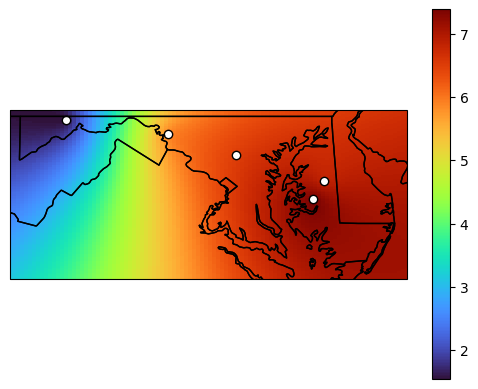

In [119]:
import matplotlib.pyplot as plt
import cartopy
from scipy.interpolate import griddata
from scipy.interpolate import RBFInterpolator
import numpy as np

coord_dict = {
    'MDMSNT-01': (39.26249, -76.92580),
    'MDMSNT-02': (39.67557, -78.93353),
    'MDMSNT-03': (39.50959, -77.72659),
    'MDMSNT-04': (38.74357, -76.01185),
    'MDMSNT-05': (38.95357, -75.88281),
}

tlat = 39.8
blat = 37.8
llon = -79.6
rlon = -74.9

lats = [coords[0] for coords in coord_dict.values()]
lons = [coords[1] for coords in coord_dict.values()]
coords = list(coord_dict.values())

df_sub = df[df['TMSTAMP'] == '2024-02-03 00:00:00']

fig = plt.figure()
ax = fig.add_subplot(projection=ccrs.PlateCarree())


xgrid = np.mgrid[blat:tlat:100j, llon:rlon:100j]
xflat = xgrid.reshape(2, -1).T

yflat = RBFInterpolator(coords, temp_obs, kernel='linear')(xflat)
ygrid = yflat.reshape(100, 100)



# grid_z = griddata((lats, lons), temp_obs, (grid_x, grid_y), method='cubic', fill_value=np.nan)


im = ax.pcolormesh(xgrid[1], xgrid[0], ygrid, cmap='turbo',
#                    shading='gouraud',
#                    vmin=1, vmax=8
                  )

ax.scatter(np.array(coords).T[1], np.array(coords).T[0], edgecolor='black', color='white')

# im = ax.tripcolor(lons, lats, temp_obs,
#                   shading='gouraud',
#                   cmap='turbo',
#                  )



ax.add_feature(cartopy.feature.COASTLINE)
ax.add_feature(cartopy.feature.STATES)
ax.set_xlim((llon, rlon))
ax.set_ylim((blat, tlat))
# ax.set_xticks([-76,-77,-78],
#               crs=ccrs.PlateCarree()
#              )
plt.colorbar(im)

In [102]:
np.array(coords).T

array([[ 39.26249,  39.67557,  39.50959,  38.74357,  38.95357],
       [-76.9258 , -78.93353, -77.72659, -76.01185, -75.88281]])

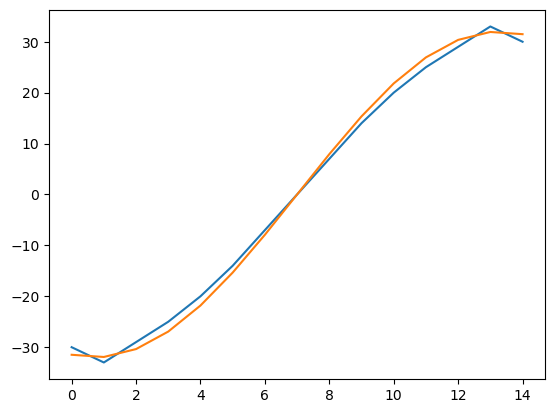

In [1]:
import numpy as np
import matplotlib.pyplot as plt

skew = [-30, -33, -29, -25, -20, -14, -7, 0, 7, 14, 20, 25, 29, 33, 30]

plt.plot(skew)
plt.plot(32*np.sin(0.25*np.arange(1,len(skew)+1) - 2.0))

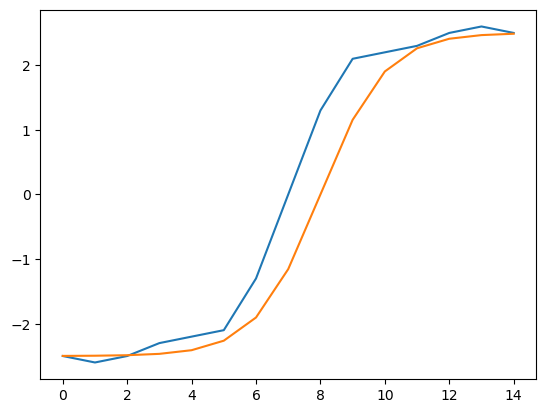

In [55]:
rake = [-2.5, -2.6, -2.5, -2.3, -2.2, -2.1, -1.3, 0, 1.3, 2.1, 2.2, 2.3, 2.5, 2.6, 2.5]

x = np.arange(0,15)

plt.plot(rake)
plt.plot(5/(1+np.exp(-(x-8))) - 2.5)

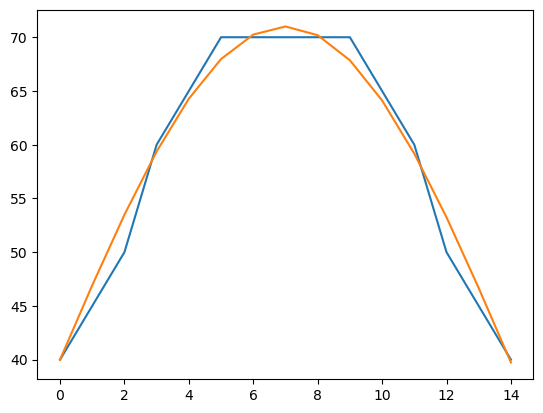

In [68]:
aoa = [40, 45, 50, 60, 65, 70, 70, 70, 70, 70, 65, 60, 50, 45, 40]

plt.plot(aoa)
plt.plot(31*np.sin(0.225*x) + 40)

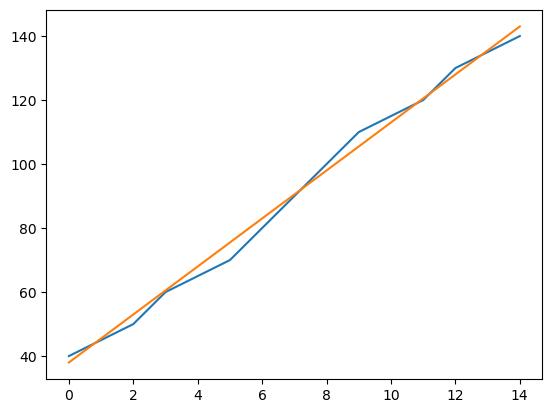

In [9]:
aoa = [40, 45, 50, 60, 65, 70, 80, 90, 100, 110, 115, 120, 130, 135, 140]

x = np.arange(0,15)

plt.plot(aoa)
plt.plot(7.5*x + 38)

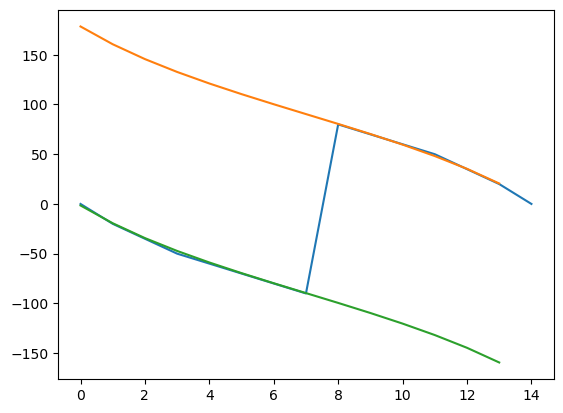

In [123]:
roll = [0, -20, -35, -50, -60, -70, -80, -90, 80, 70, 60, 50, 35, 20, 0]
roll2 = [180, 160, 145, 130, 120, 110, 100, 90, 80, 70, 60, 50, 35, 20, 0]

x = np.arange(1,15)

plt.plot(roll)
# plt.plot(roll2)
# plt.plot(75*np.sin(0.24*x - 0.2))
plt.plot(88*np.tan(-0.112*x + 0.9) + 90)
plt.plot(88*np.tan(-0.112*x + 0.9) + 90 - 180)

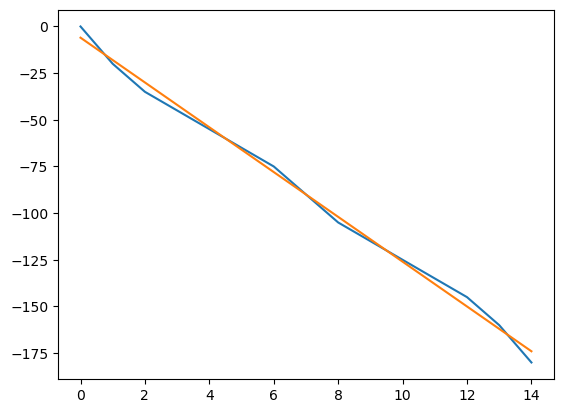

In [16]:
roll = [0, -20, -35, -45, -55, -65, -75, -90, -105, -115, -125, -135, -145, -160, -180]

x=np.arange(1,16)
plt.plot(roll)
plt.plot(-12*x+6)

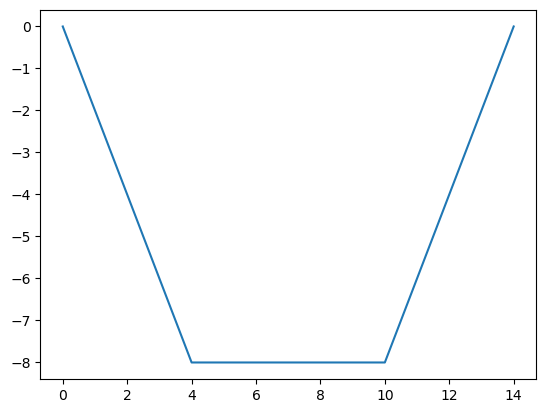

In [27]:
vert = [0, -2, -4, -6, -8, -8, -8, -8, -8, -8, -8, -6, -4, -2, 0]

plt.plot(vert)

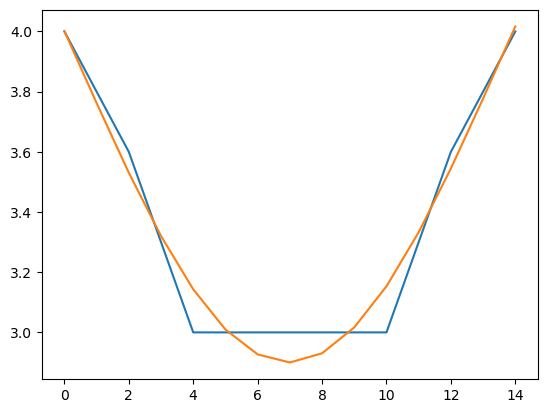

In [172]:
scale = [4, 3.8, 3.6, 3.3, 3, 3, 3, 3, 3, 3, 3, 3.3, 3.6, 3.8, 4]

x=np.arange(1,16)

plt.plot(scale)
plt.plot(np.sin(0.24*x + 2.8) + 3.9)

C:\Users\aspen\AppData\Local\Temp\ipykernel_30636\3681614530.py:25: RuntimeWarning: divide by zero encountered in divide
  P_sat = np.exp(2 * gamma * Molar_mass_NaCl / (R * T_K * rho * a) - Delta_Hv / (R * (1/T_K - 1/T_0)))
C:\Users\aspen\AppData\Local\Temp\ipykernel_30636\3681614530.py:25: RuntimeWarning: overflow encountered in exp
  P_sat = np.exp(2 * gamma * Molar_mass_NaCl / (R * T_K * rho * a) - Delta_Hv / (R * (1/T_K - 1/T_0)))


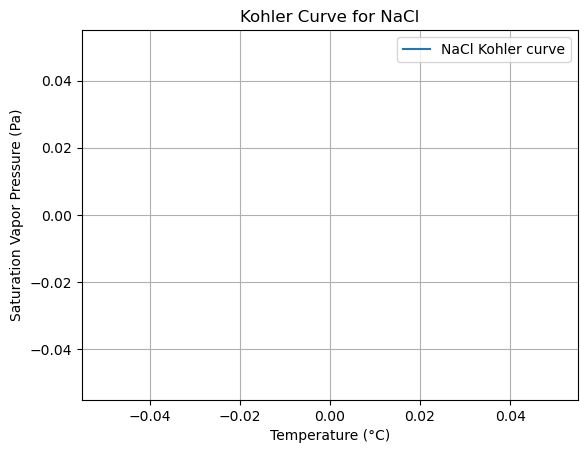

In [173]:
import numpy as np
import matplotlib.pyplot as plt

# Constants
R = 8.314  # Ideal gas constant (J/(mol*K))
Molar_mass_NaCl = 58.44  # Molar mass of NaCl (g/mol)

# Given parameters for NaCl
a = 5.6402e-10  # Lattice parameter (m)
rho = 2.165e3  # Density of NaCl (kg/m^3)

# Function to calculate saturation vapor pressure over NaCl droplets
def vapor_pressure(T, a, rho):
    # Calculate the Kelvin temperature
    T_K = T + 273.15  # Convert Celsius to Kelvin

    # Calculate saturation vapor pressure using the Kohler equation
    # Kohler equation: ln(P/P_sat) = 2γM/(RTρr) - ΔHv/R(1/T - 1/T_0)
    # Assume for simplicity ΔHv = 40.7 kJ/mol (heat of vaporization)
    # and γ = 0.072 J/m^2 (surface tension)
    gamma = 0.072
    Delta_Hv = 40.7e3  # J/mol
    T_0 = 273.15  # Reference temperature (K)
    
    P_sat = np.exp(2 * gamma * Molar_mass_NaCl / (R * T_K * rho * a) - Delta_Hv / (R * (1/T_K - 1/T_0)))
    
    return P_sat

# Temperature range for the Kohler curve (in Celsius)
T_range = np.linspace(0, 40, 100)

# Calculate saturation vapor pressure over NaCl droplets for each temperature
P_sat_values = vapor_pressure(T_range, a, rho)

# Plotting the Kohler curve
plt.plot(T_range, P_sat_values, label='NaCl Kohler curve')
plt.xlabel('Temperature (°C)')
plt.ylabel('Saturation Vapor Pressure (Pa)')
plt.title('Kohler Curve for NaCl')
plt.legend()
plt.grid(True)
plt.show()

In [2]:
import numpy as np
import matplotlib.pyplot as plt

i = 2
rho_w = 997 # kg/m^3
sigma = 0.075 # N/m
R_v = 461 # J/K/kg
T = 280 # K
m_v = 0.01802 # kg/mol

def kohler(r, m_s, r_s, rho_s):
    M = rho_s*4*np.pi*r_s**3 / 3
    a = 2*sigma / (R_v*T*rho_w)
    b = 3*i*m_v*M / (4*np.pi*rho_w*m_s)
    return 1 + a/r - b/np.power(r, 3)

def kelvin(r):
    a = 2*sigma / (R_v*T*rho_w)
    return 1 + a/r

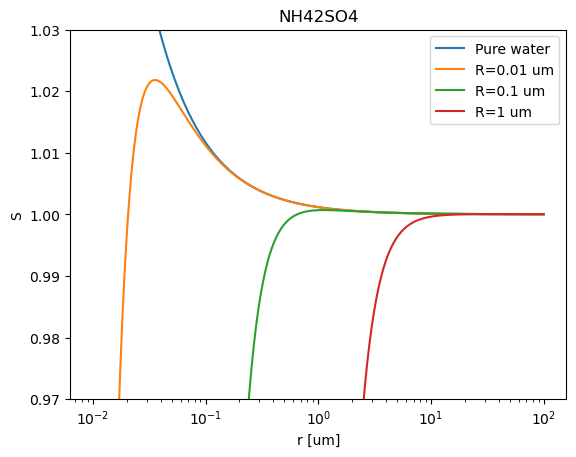

In [3]:
# nh4
m_s = 0.132 # kg/mol
rho_s = 0.0018 # kg/cm^3

r = np.logspace(-8, -4, num=200)

plt.plot(r*1e6, kelvin(r), label='Pure water')

r_s = 1e-6 # cm
es = kohler(r, m_s, r_s, rho_s)
plt.plot(r*1e6, es, label='R=0.01 um')
r_s = 1e-5 # cm
es = kohler(r, m_s, r_s, rho_s)
plt.plot(r*1e6, es, label='R=0.1 um')
r_s = 1e-4 # cm
es = kohler(r, m_s, r_s, rho_s)
plt.plot(r*1e6, es, label='R=1 um')
plt.xscale('log')
plt.ylim(0.97, 1.03)
plt.xlabel('r [um]')
plt.ylabel('S')
plt.title('NH42SO4')
plt.legend()

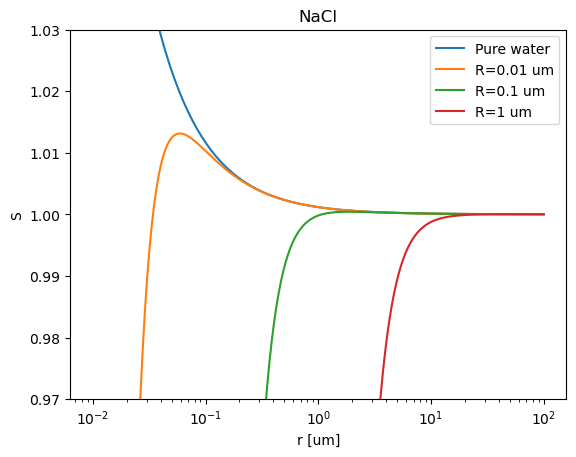

In [4]:
# nacl
m_s = 0.05844 # kg/mol
rho_s = 0.0022 # kg/cm^3

r = np.logspace(-8, -4, num=200)

plt.plot(r*1e6, kelvin(r), label='Pure water')

r_s = 1e-6 # cm
es = kohler(r, m_s, r_s, rho_s)
plt.plot(r*1e6, es, label='R=0.01 um')
r_s = 1e-5 # cm
es = kohler(r, m_s, r_s, rho_s)
plt.plot(r*1e6, es, label='R=0.1 um')
r_s = 1e-4 # cm
es = kohler(r, m_s, r_s, rho_s)
plt.plot(r*1e6, es, label='R=1 um')
plt.xscale('log')
plt.ylim(0.97, 1.03)
plt.xlabel('r [um]')
plt.ylabel('S')
plt.title('NaCl')
plt.legend()

In [63]:
6/2*3

9.0

In [ ]:
i = 2
rho_w = 997 # kg/m^3
sigma = 0.075 # N/m
R_v = 461 # J/K/kg
T = 280 # K
m_v = 0.01802 # kg/mol
m_s = 0.05844 # kg/mol

# NaCl
rho_s = 0.0022 # kg/cm^3
r_s = 0.1e-4 # cm
M = rho_s*4*np.pi*r_s**3 / 3
print(M)
# M = 10e-18 # kg

a = 2*sigma / (R_v*T*rho_w)
b = 3*i*m_v*M / (4*np.pi*rho_w*m_s)

r = np.linspace(0.000001, 0.00001, 200)
es = 1 + a/r - b/np.power(r, 3)
plt.plot(r, es)
# plt.ylim(-0.5, 0.5)